# EDA

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
df_games = pd.read_parquet('data/df_games.parquet')

In [4]:
df_games.columns

Index(['genres', 'title', 'price', 'id', 'developer', 'anio'], dtype='object')

In [5]:
df_games.dtypes

genres        object
title         object
price        float64
id            object
developer     object
anio          object
dtype: object

In [6]:
df_games.info

<bound method DataFrame.info of                                                    genres  \
index                                                       
88310       [Action, Casual, Indie, Simulation, Strategy]   
88311                [Free to Play, Indie, RPG, Strategy]   
88312   [Casual, Free to Play, Indie, Simulation, Sports]   
88313                         [Action, Adventure, Casual]   
88315                     [Action, Adventure, Simulation]   
...                                                   ...   
120439                 [Action, Adventure, Casual, Indie]   
120440              [Casual, Indie, Simulation, Strategy]   
120441                          [Casual, Indie, Strategy]   
120442                        [Indie, Racing, Simulation]   
120443                                    [Casual, Indie]   

                           title  price      id                 developer  \
index                                                                       
88310        Lost Su

In [10]:
# Agregar columnas al dataset para poder hacer el recuento de cada genero

#Vemos todos los generos de los juegos que tenemos
listaDeGeneros = []
for generos in df_games['genres']:
  for genero in generos:
    if genero not in listaDeGeneros:
      listaDeGeneros.append(genero)

# Los inicializamos en 0
df_games[listaDeGeneros] = 0

# Aplicamos un 1 en cada uno a cada juego que pertenece a X genero.
for indice, generos in enumerate(df_games['genres']):
  for genero in generos:
    df_games[genero].iloc[indice] = 1



#Guaradmos los datos en otro dataframe para que quede mas ordenado.
generos = []
cantidad = []
for genero in listaDeGeneros:
    generos.append(genero)
    cantidad.append(df_games[genero].value_counts()[1])

juegos = pd.DataFrame()
juegos['Genero'] = generos
juegos['Cantidad'] = cantidad

C:\Users\SimpleDeco\AppData\Local\Temp\ipykernel_7392\1110818582.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_games[genero].iloc[indice] = 1
C:\Users\SimpleDeco\AppData\Local\Temp\ipykernel_7392\1110818582.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_games[genero].iloc[indice] = 1
C:\Users\SimpleDeco\AppData\Local\Temp\ipykernel_7392\1110818582.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_games[genero].

# Cantidad de juegos por genero

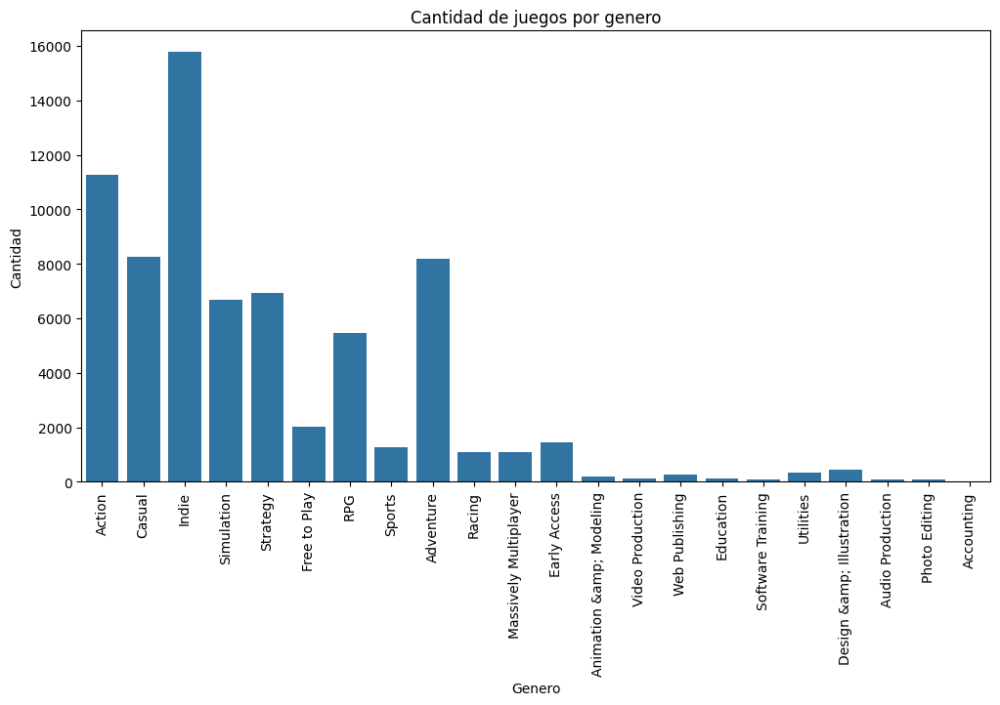

In [11]:
plt.figure(figsize=(12, 6)) 
sns.barplot(data=juegos, x='Genero', y='Cantidad')
plt.title('Cantidad de juegos por genero')
plt.xticks(rotation=90)
plt.show()

In [18]:
juegos

Genero
Indie        15764
Action       11255
Casual        8256
Adventure     8194
Strategy      6930
Name: Cantidad, dtype: int64

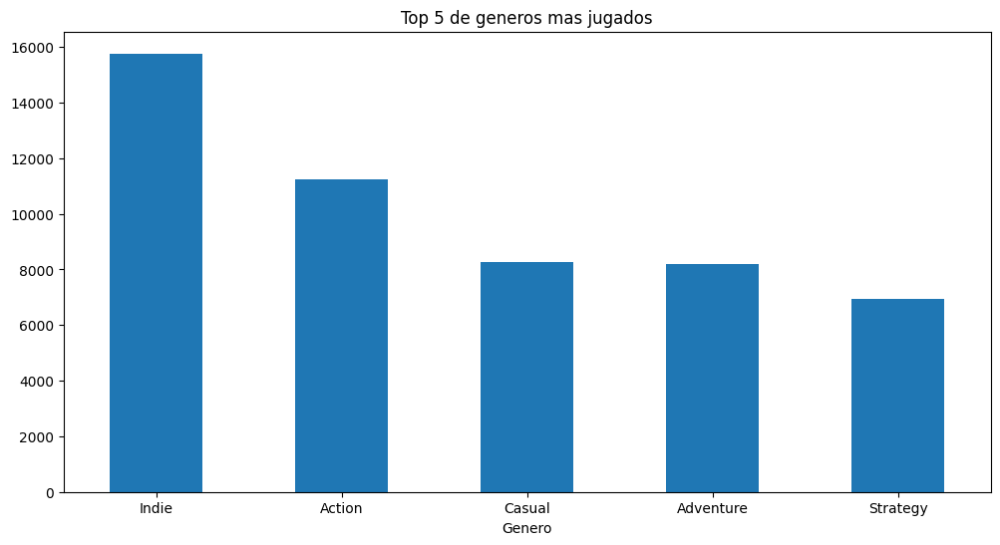

In [20]:
# juegos = juegos.groupby('Genero').sum()['Cantidad'].sort_values(ascending=False).head(5)

# Graficamos
plt.figure(figsize=(12, 6)) 
juegos.plot(kind='bar')
plt.title('Top 5 de generos mas jugados')
plt.xticks(rotation=0)
plt.show()



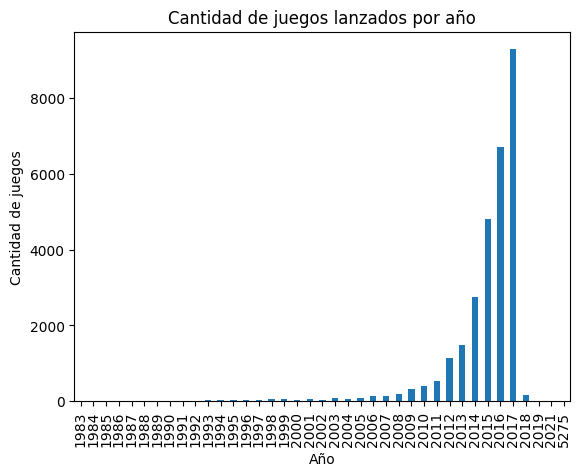

In [21]:
juegosPorAño = df_games['anio'].value_counts().sort_index()
juegosPorAño.plot(kind='bar')
plt.title('Cantidad de juegos lanzados por año')
plt.xlabel('Año')
plt.ylabel('Cantidad de juegos')
plt.xticks(rotation=90)
plt.show()